In [ ]:
from google.colab import drive
drive.mount('/content/drive')

!pip install torch torchvision torchaudio
!pip install 'git+https://github.com/facebookresearch/detectron2.git'

Mounted at /content/drive
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-r5ndm8de
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-r5ndm8de
  Resolved https://github.com/facebookresearch/detectron2.git to commit c69939aa85460e8135f40bce908a6cddaa73065f
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 1.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.2/79.2 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 10.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 41.9 MB/s eta 0:00:00
  Created wheel for detectron2: f

In [ ]:
import detectron2
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances

register_coco_instances("train_data", {}, "/content/drive/MyDrive/detectron_dataset/train/_annotations.coco.json", "/content/drive/MyDrive/detectron_dataset/train")
register_coco_instances("val_data", {}, "/content/drive/MyDrive/detectron_dataset/valid/_annotations.coco.json", "/content/drive/MyDrive/detectron_dataset/valid")
register_coco_instances("test_data", {}, "/content/drive/MyDrive/detectron_dataset/test/_annotations.coco.json", "/content/drive/MyDrive/detectron_dataset/test")

MetadataCatalog.get("train_data").set(thing_classes=["Image", "Image Description", "Sub Title", "Table", "Text Block", "Title"])
MetadataCatalog.get("val_data").set(thing_classes=["Image", "Image Description", "Sub Title", "Table", "Text Block", "Title"])

from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo

cfg = get_cfg()

# config file from Detectron2's model zoo (Faster R-CNN, for instance)
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("train_data",)
cfg.DATASETS.TEST = ("val_data",)
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 10000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 6

cfg.OUTPUT_DIR = "/content/drive/MyDrive/detectron_dataset/output"

from detectron2.engine import DefaultTrainer

trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()



In [ ]:
!pip install opencv-python-headless
!pip install scikit-image
!sudo apt install tesseract-ocr
!pip install pytesseract
!sudo apt-get install tesseract-ocr-hin

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr is already the newest version (4.1.1-2.1build1).
tesseract-ocr set to manually installed.
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr-hin is already the newest version (1:4.00~git30-7274cfa-1.1).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


Dropdown(description='Dataset Type:', options=('novel', 'paper', 'story'), value='novel')

FileUpload(value={}, accept='image/*', description='Upload')

FileUpload(value={}, accept='.txt', description='Upload')

/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

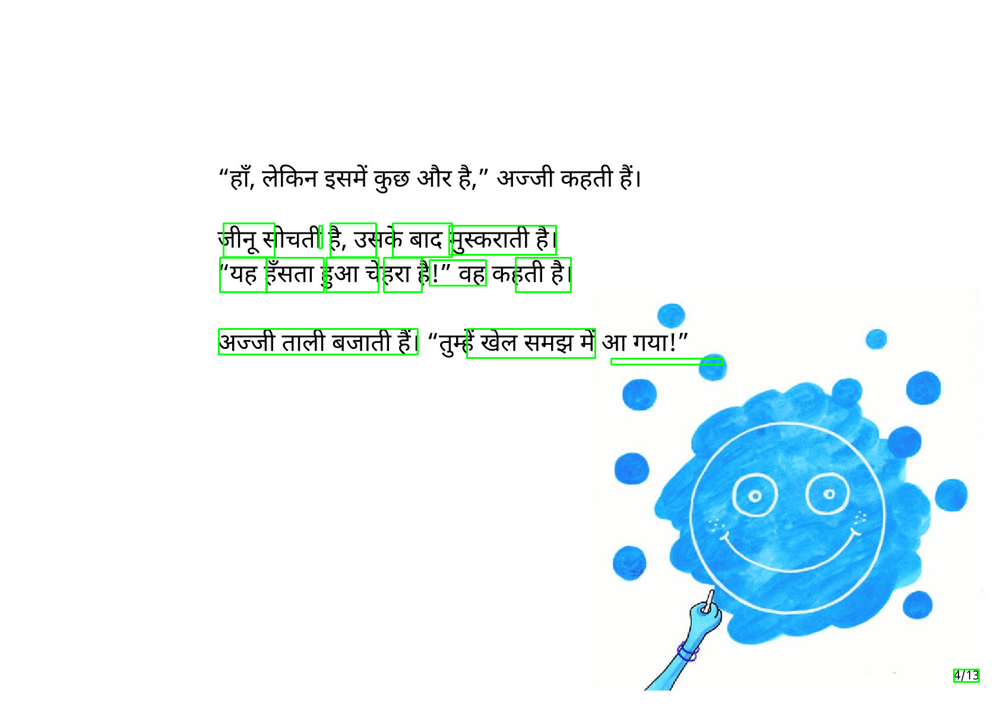

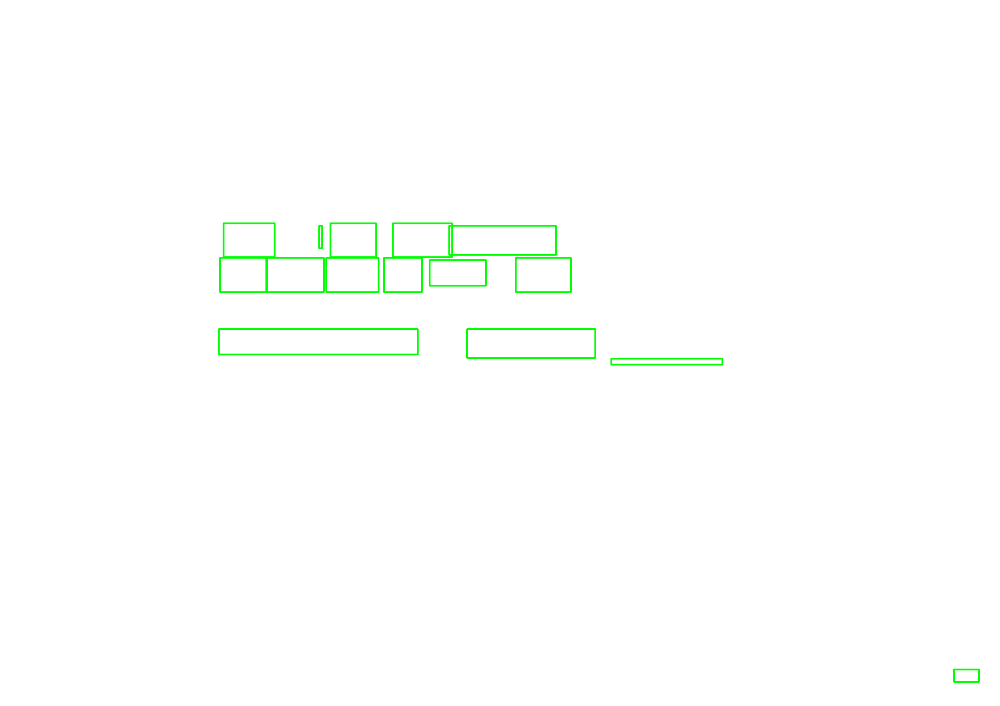

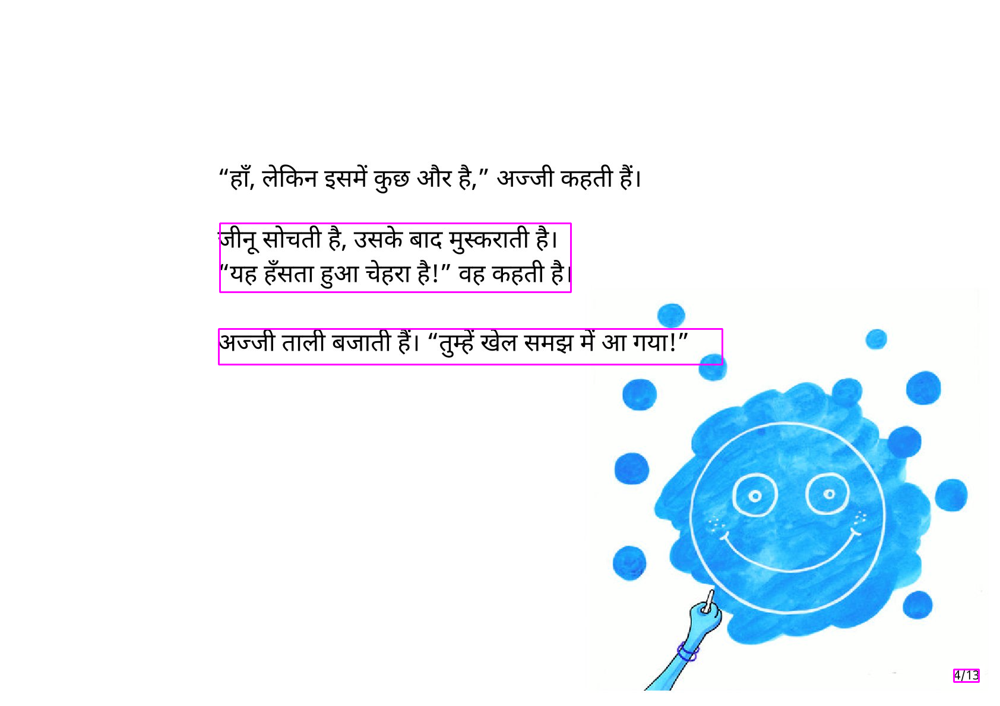

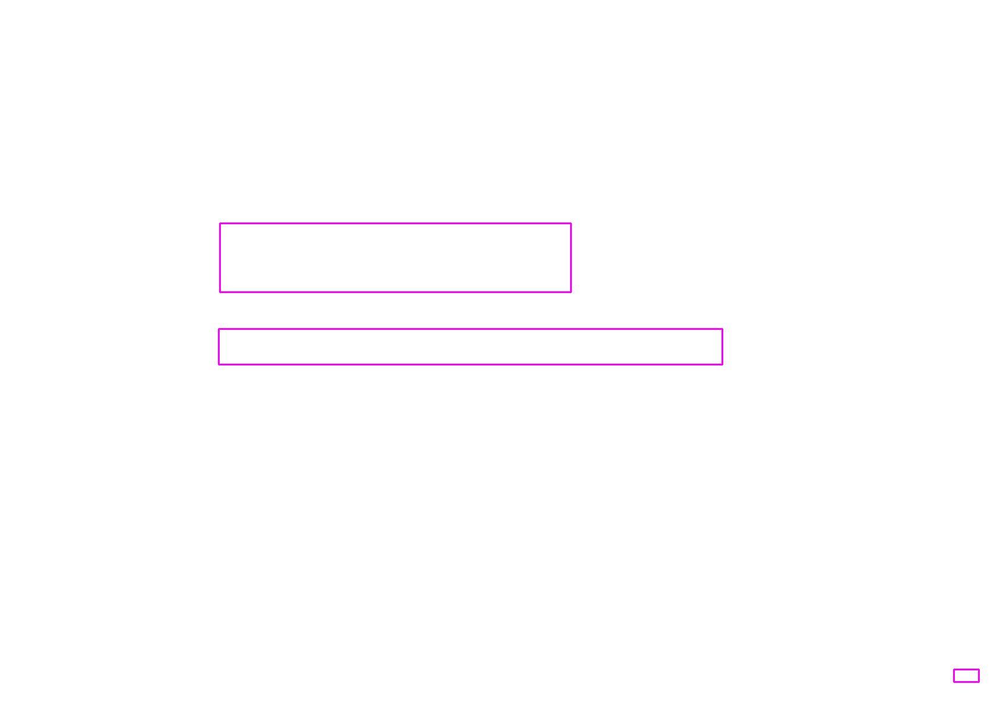

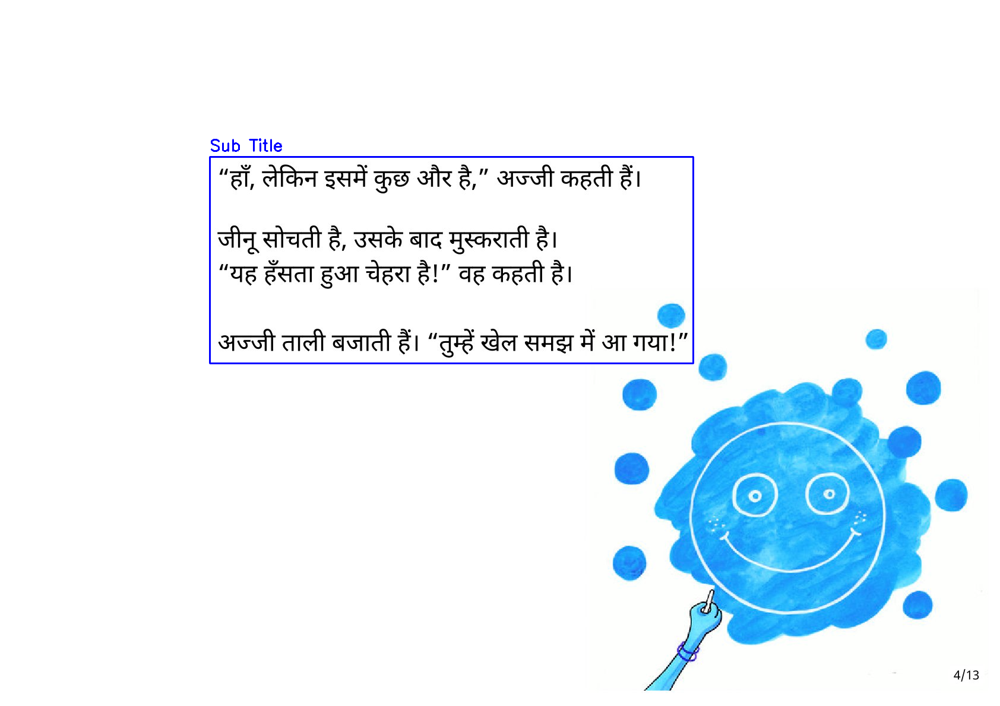

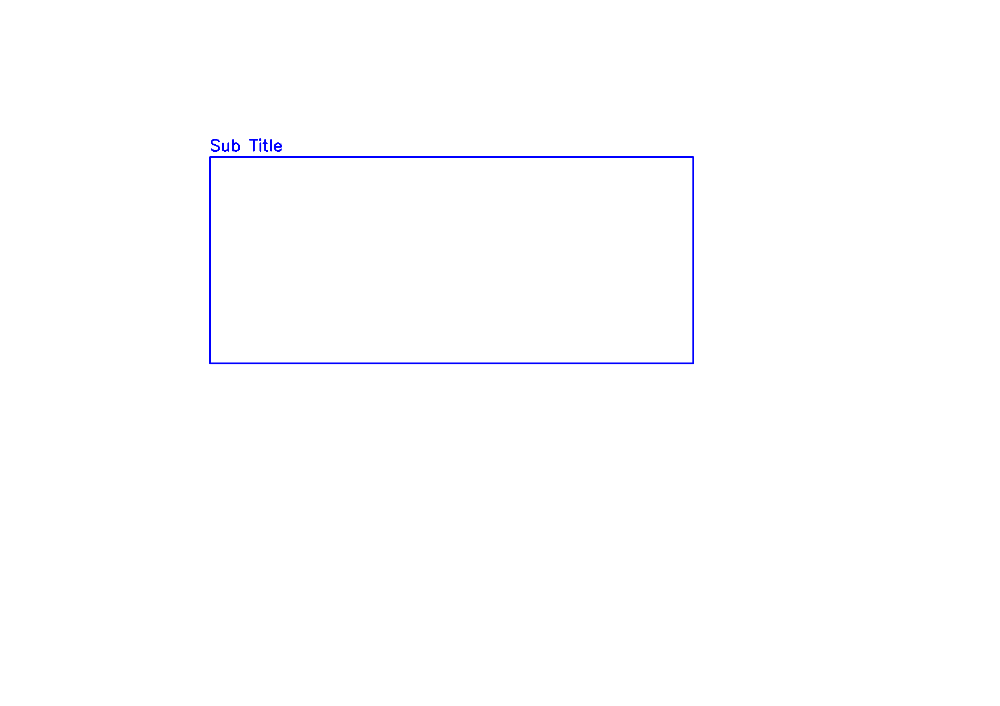

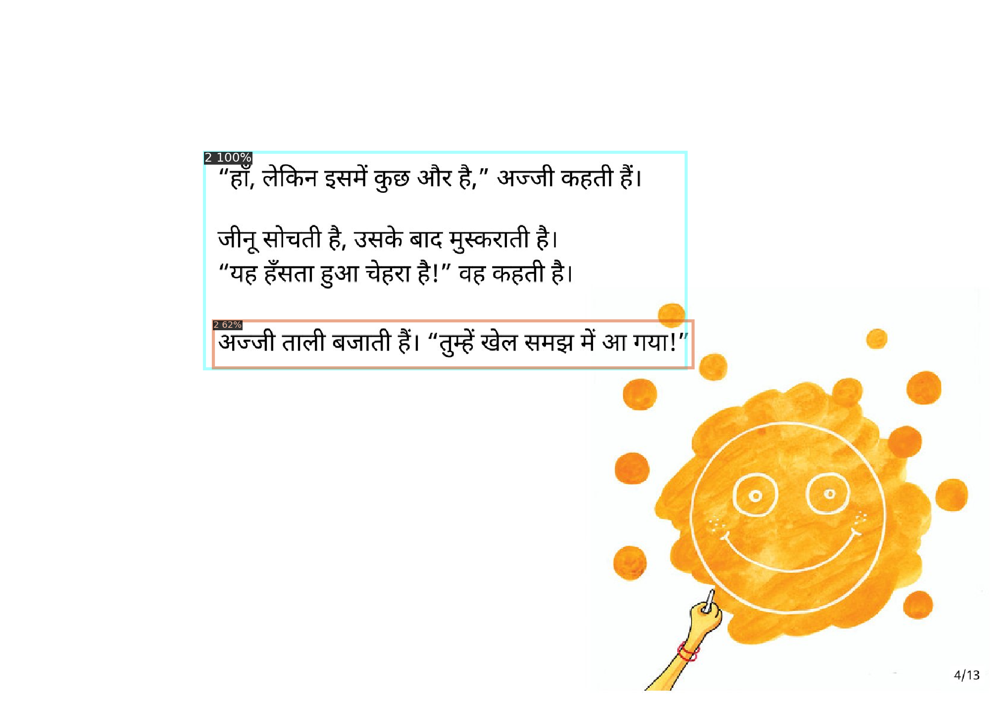

/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


True Positives: 1
False Positives: 1.0
False Negatives: 0.0
Precision: 0.5
Recall: 1.0
F1-Score: 0.6666666666666666
IoU Score: 3.1649243823536786
Mean IoU: nan


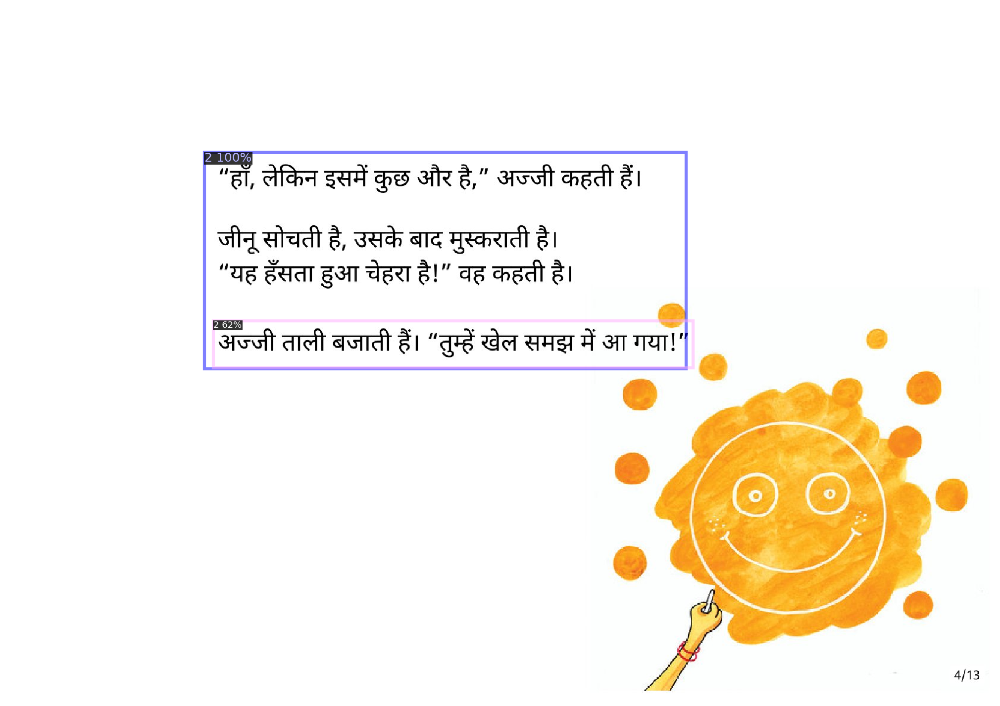

In [ ]:
import cv2
import numpy as np
import pytesseract
import os
from shapely.geometry import Polygon, box as shapely_box
from google.colab.patches import cv2_imshow
from io import BytesIO
from PIL import Image
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import ipywidgets as widgets
from IPython.display import display, clear_output

os.environ['TESSDATA_PREFIX'] = '/usr/share/tesseract-ocr/4.00/tessdata'

# Visualization functions
def visualize_word_boxes_on_image(image, word_boxes):
    image_copy = image.copy()  # Create a fresh copy of the image
    for box in word_boxes:
        cv2.rectangle(image_copy, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
    cv2_imshow(image_copy)

def visualize_word_boxes_on_white(image, word_boxes):
    height, width, _ = image.shape
    white_img = np.ones_like(image) * 255
    for box in word_boxes:
        cv2.rectangle(white_img, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
    cv2_imshow(white_img)

def visualize_paragraph_boxes_on_image(image, paragraph_boxes):
    image_copy = image.copy()  # Create a fresh copy of the image
    for box in paragraph_boxes:
        cv2.rectangle(image_copy, (box[0], box[1]), (box[2], box[3]), (255, 0, 255), 2)
    cv2_imshow(image_copy)

def visualize_paragraph_boxes_on_white(image, paragraph_boxes):
    height, width, _ = image.shape
    white_img = np.ones_like(image) * 255
    for box in paragraph_boxes:
        cv2.rectangle(white_img, (box[0], box[1]), (box[2], box[3]), (255, 0, 255), 2)
    cv2_imshow(white_img)

def visualize_yolo_annotations(image, annotation_data):
    image_copy = image.copy()  # Create a fresh copy of the image
    height, width, _ = image.shape
    label_colors = {
        "Image": (0, 0, 255),
        "Image Description": (0, 255, 0),
        "Sub Title": (255, 0, 0),
        "Table": (255, 255, 0),
        "Paragraph": (255, 0, 255),
        "Title": (0, 255, 255)
    }

    for line in annotation_data:
        data = line.strip().split()
        class_id, x_center, y_center, w, h = map(float, data)
        x_center *= width
        y_center *= height
        w *= width
        h *= height
        xmin = int(x_center - w / 2)
        ymin = int(y_center - h / 2)
        xmax = int(x_center + w / 2)
        ymax = int(y_center + h / 2)

        label_names = list(label_colors.keys())
        if 0 <= int(class_id) < len(label_names):
            label_name = label_names[int(class_id)]
            color = label_colors[label_name]
            label = f"{label_name}"
            cv2.rectangle(image_copy, (xmin, ymin), (xmax, ymax), color, 2)
            cv2.putText(image_copy, label, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

    cv2_imshow(image_copy)

def visualize_yolo_on_white(image, annotation_data):
    height, width, _ = image.shape
    white_img = np.ones_like(image) * 255
    label_colors = {
        "Image": (0, 0, 255),
        "Image Description": (0, 255, 0),
        "Sub Title": (255, 0, 0),
        "Table": (255, 255, 0),
        "Paragraph": (255, 0, 255),
        "Title": (0, 255, 255)
    }

    for line in annotation_data:
        data = line.strip().split()
        class_id, x_center, y_center, w, h = map(float, data)
        x_center *= width
        y_center *= height
        w *= width
        h *= height
        xmin = int(x_center - w / 2)
        ymin = int(y_center - h / 2)
        xmax = int(x_center + w / 2)
        ymax = int(y_center + h / 2)

        label_names = list(label_colors.keys())
        if 0 <= int(class_id) < len(label_names):
            label_name = label_names[int(class_id)]
            color = label_colors[label_name]
            label = f"{label_name}"
            cv2.rectangle(white_img, (xmin, ymin), (xmax, ymax), color, 2)
            cv2.putText(white_img, label, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

    cv2_imshow(white_img)

# Combine word boxes into paragraphs
def combine_boxes(boxes, threshold_vertical_gap=8, threshold_horizontal_gap=14):
    if not boxes:
        return []

    boxes.sort(key=lambda box: box[1])

    lines = []
    current_line = [boxes[0]]
    for box in boxes[1:]:
        prev_box = current_line[-1]
        vertical_gap = box[1] - prev_box[3]
        if vertical_gap <= max(threshold_vertical_gap, prev_box[3] - prev_box[1]):
            current_line.append(box)
        else:
            lines.append(current_line)
            current_line = [box]
    lines.append(current_line)

    paragraph_boxes = []
    for line in lines:
        line.sort(key=lambda box: box[0])
        current_paragraph = [line[0]]
        for box in line[1:]:
            prev_box = current_paragraph[-1]
            horizontal_gap = box[0] - prev_box[2]
            if horizontal_gap <= max(threshold_horizontal_gap, prev_box[2] - prev_box[0]):
                current_paragraph.append(box)
            else:
                min_x = min(b[0] for b in current_paragraph)
                min_y = min(b[1] for b in current_paragraph)
                max_x = max(b[2] for b in current_paragraph)
                max_y = max(b[3] for b in current_paragraph)
                paragraph_boxes.append((min_x, min_y, max_x, max_y))
                current_paragraph = [box]

        min_x = min(b[0] for b in current_paragraph)
        min_y = min(b[1] for b in current_paragraph)
        max_x = max(b[2] for b in current_paragraph)
        max_y = max(b[3] for b in current_paragraph)
        paragraph_boxes.append((min_x, min_y, max_x, max_y))

    return paragraph_boxes

def calculate_iou(box1, box2):
    """Calculates Intersection over Union (IoU) between two boxes."""
    poly_1 = Polygon([(box1[0], box1[1]), (box1[2], box1[1]), (box1[2], box1[3]), (box1[0], box1[3])])
    poly_2 = Polygon([(box2[0], box2[1]), (box2[2], box2[1]), (box2[2], box2[3]), (box2[0], box2[3])])
    iou = poly_1.intersection(poly_2).area / poly_1.union(poly_2).area
    return iou


def calculate_accuracies(gt_boxes, pred_boxes):
    tp = 0  # True Positives
    fp = 0  # False Positives
    fn = 0  # False Negatives
    total_gt_area = 0  # Total area of ground truth boxes
    total_pred_area = 0  # Total area of predicted boxes
    intersection_area = 0  # Total overlapping area between GT and predictions

    gt_matched = np.zeros(len(gt_boxes))  # Keep track of matched ground truth boxes
    pred_matched = np.zeros(len(pred_boxes))  # Keep track of matched predicted boxes

    for i, gt_box in enumerate(gt_boxes):
        iou_max = 0
        match_j = -1
        for j, pred_box in enumerate(pred_boxes):
            iou = calculate_iou(gt_box, pred_box)
            if iou > iou_max:
                iou_max = iou
                match_j = j
        if iou_max > 0.5:  # IoU threshold for a correct match
            tp += 1
            gt_matched[i] = 1
            pred_matched[match_j] = 1
            total_gt_area += (gt_box[2] - gt_box[0]) * (gt_box[3] - gt_box[1])
            total_pred_area += (pred_box[2] - pred_box[0]) * (pred_box[3] - pred_box[1])
            intersection_area += iou_max * (gt_box[2] - gt_box[0]) * (gt_box[3] - gt_box[1])

    fn = len(gt_boxes) - sum(gt_matched)
    fp = len(pred_boxes) - sum(pred_matched)

    # Calculate accuracy parameters
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
    iou_score = intersection_area / (total_gt_area + total_pred_area - intersection_area) if (total_gt_area + total_pred_area - intersection_area) > 0 else 0

    # Additional accuracy parameters
    mean_iou = np.mean([calculate_iou(gt_boxes[i], pred_boxes[j])
                       for i in range(len(gt_boxes)) if gt_matched[i]
                       for j in range(len(pred_boxes)) if pred_matched[j] and iou > 0.5]) if tp > 0 else 0

    return {
        "True Positives": tp,
        "False Positives": fp,
        "False Negatives": fn,
        "Precision": precision,
        "Recall": recall,
        "F1-Score": f1_score,
        "IoU Score": iou_score,
        "Mean IoU": mean_iou,
    }

# Setup predictor for multiple datasets with dynamic classes
def setup_predictor(dataset_type):
    # Define weights and class information dynamically
    model_info = {
        'novel': {
            'weights': '/content/drive/MyDrive/detectron_dataset/novel/output/model_final.pth',
            'classes': ['Image', 'Image Description', 'Sub Title', 'Table', 'Paragraph', 'Title']
        },
        'paper': {
            'weights': '/content/drive/MyDrive/detectron_dataset/paper/output/model_final.pth',
            'classes': ['Abstract Body', 'Abstract Heading', 'Author', 'Body', 'Footer Info', 'Heading', 'Journal Header', 'Journal Info', 'Keywords', 'Title']
        },
        'story': {
            'weights': '/content/drive/MyDrive/detectron_dataset/story/output/model_final.pth',
            'classes': ['Image', 'Sub Title', 'Text Block', 'Title']
        }
    }

    # Fetch the appropriate model weight path and classes based on dataset type
    model_data = model_info[dataset_type]
    model_weights = model_data['weights']
    class_names = model_data['classes']
    num_classes = len(class_names)

    # Setup the configuration
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
    cfg.MODEL.WEIGHTS = model_weights
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = num_classes
    cfg.MODEL.DEVICE = "cpu"

    return DefaultPredictor(cfg), class_names, num_classes

# Process and display results
def process_uploaded_files_with_model(image_file, annotation_file, dataset_type):
    image_data = BytesIO(image_file['content'])
    image = np.array(Image.open(image_data))
    annotation_data = annotation_file['content'].decode('utf-8').strip().split("\n")

    # Extracting word-level bounding boxes using pytesseract
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    _, binary_image = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY_INV)
    data = pytesseract.image_to_data(binary_image, output_type=pytesseract.Output.DICT)
    word_boxes = []
    for i, word in enumerate(data['text']):
        if word.strip():
            (x, y, w, h) = (data['left'][i], data['top'][i], data['width'][i], data['height'][i])
            word_boxes.append((x, y, x + w, y + h))

    # Combine word boxes into paragraph boxes
    paragraph_boxes = combine_boxes(word_boxes)

    # Get the predictor, class names, and class count dynamically based on the selected model
    predictor, class_names, num_classes = setup_predictor(dataset_type)

    # Visualize the bounding boxes
    visualize_word_boxes_on_image(image, word_boxes)
    visualize_word_boxes_on_white(image, word_boxes)
    visualize_paragraph_boxes_on_image(image, paragraph_boxes)
    visualize_paragraph_boxes_on_white(image, paragraph_boxes)
    visualize_yolo_annotations(image, annotation_data)
    visualize_yolo_on_white(image, annotation_data)

    # Extract ground truth boxes from annotation data
    height, width, _ = image.shape
    gt_boxes = []
    for line in annotation_data:
        data = line.strip().split()
        class_id, x_center, y_center, w, h = map(float, data)
        x_center *= width
        y_center *= height
        w *= width
        h *= height
        xmin = int(x_center - w / 2)
        ymin = int(y_center - h / 2)
        xmax = int(x_center + w / 2)
        ymax = int(y_center + h / 2)
        gt_boxes.append((xmin, ymin, xmax, ymax))

    # Predict and get predicted boxes
    outputs = predictor(np.array(Image.open(BytesIO(image_file['content']))))
    pred_boxes = outputs["instances"].pred_boxes.tensor.cpu().numpy()
    pred_boxes = [[int(coord) for coord in box] for box in pred_boxes]

    # Visualize and predict using the updated predictor
    outputs = predictor(np.array(Image.open(BytesIO(image_file['content']))))
    visualizer = Visualizer(np.array(Image.open(BytesIO(image_file['content']))), MetadataCatalog.get(dataset_type), scale=1.2)
    result_image = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(result_image.get_image()[:, :, ::-1])

    # Calculate and display accuracies (This is now after Detectron2 output)
    accuracies = calculate_accuracies(gt_boxes, pred_boxes)
    for key, value in accuracies.items():
        print(f"{key}: {value}")

# Dropdown for selecting dataset
dataset_type_dropdown = widgets.Dropdown(
    options=['novel', 'paper', 'story'],
    value='novel',
    description='Dataset Type:',
)

# File upload widgets
upload_image_widget = widgets.FileUpload(accept='image/*', multiple=False)
upload_annotation_widget = widgets.FileUpload(accept='.txt', multiple=False)

display(dataset_type_dropdown, upload_image_widget, upload_annotation_widget)

def on_upload_and_selection_change(change):
    if upload_image_widget.value and upload_annotation_widget.value and dataset_type_dropdown.value:
        image_file = next(iter(upload_image_widget.value.values()))
        annotation_file = next(iter(upload_annotation_widget.value.values()))
        dataset_type = dataset_type_dropdown.value

        # Get the predictor, class names, and class count dynamically based on the selected model
        predictor, class_names, num_classes = setup_predictor(dataset_type)

        # Process the image with the updated model setup
        process_uploaded_files_with_model(image_file, annotation_file, dataset_type)

        # Visualize and predict using the updated predictor
        outputs = predictor(np.array(Image.open(BytesIO(image_file['content']))))
        visualizer = Visualizer(np.array(Image.open(BytesIO(image_file['content']))), MetadataCatalog.get(dataset_type), scale=1.2)
        result_image = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
        cv2_imshow(result_image.get_image()[:, :, ::-1])

# Observers
upload_image_widget.observe(on_upload_and_selection_change, names='value')
upload_annotation_widget.observe(on_upload_and_selection_change, names='value')
dataset_type_dropdown.observe(on_upload_and_selection_change, names='value')

In [ ]:
import cv2
import numpy as np
import pytesseract
import os
from shapely.geometry import Polygon, box as shapely_box
from google.colab.patches import cv2_imshow
from io import BytesIO
from PIL import Image
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import ipywidgets as widgets
from IPython.display import display, clear_output

os.environ['TESSDATA_PREFIX'] = '/usr/share/tesseract-ocr/4.00/tessdata'

# Visualization functions
def visualize_word_boxes_on_image(image, word_boxes):
    image_copy = image.copy()  # Create a fresh copy of the image
    for box in word_boxes:
        cv2.rectangle(image_copy, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
    cv2_imshow(image_copy)

def visualize_word_boxes_on_white(image, word_boxes):
    height, width, _ = image.shape
    white_img = np.ones_like(image) * 255
    for box in word_boxes:
        cv2.rectangle(white_img, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
    cv2_imshow(white_img)

def visualize_paragraph_boxes_on_image(image, paragraph_boxes):
    image_copy = image.copy()  # Create a fresh copy of the image
    for box in paragraph_boxes:
        cv2.rectangle(image_copy, (box[0], box[1]), (box[2], box[3]), (255, 0, 255), 2)
    cv2_imshow(image_copy)

def visualize_paragraph_boxes_on_white(image, paragraph_boxes):
    height, width, _ = image.shape
    white_img = np.ones_like(image) * 255
    for box in paragraph_boxes:
        cv2.rectangle(white_img, (box[0], box[1]), (box[2], box[3]), (255, 0, 255), 2)
    cv2_imshow(white_img)

def visualize_yolo_annotations(image, annotation_data):
    image_copy = image.copy()  # Create a fresh copy of the image
    height, width, _ = image.shape
    label_colors = {
        "Image": (0, 0, 255),
        "Image Description": (0, 255, 0),
        "Sub Title": (255, 0, 0),
        "Table": (255, 255, 0),
        "Paragraph": (255, 0, 255),
        "Title": (0, 255, 255)
    }

    for line in annotation_data:
        data = line.strip().split()
        class_id, x_center, y_center, w, h = map(float, data)
        x_center *= width
        y_center *= height
        w *= width
        h *= height
        xmin = int(x_center - w / 2)
        ymin = int(y_center - h / 2)
        xmax = int(x_center + w / 2)
        ymax = int(y_center + h / 2)

        label_names = list(label_colors.keys())
        if 0 <= int(class_id) < len(label_names):
            label_name = label_names[int(class_id)]
            color = label_colors[label_name]
            label = f"{label_name}"
            cv2.rectangle(image_copy, (xmin, ymin), (xmax, ymax), color, 2)
            cv2.putText(image_copy, label, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

    cv2_imshow(image_copy)

def visualize_yolo_on_white(image, annotation_data):
    height, width, _ = image.shape
    white_img = np.ones_like(image) * 255
    label_colors = {
        "Image": (0, 0, 255),
        "Image Description": (0, 255, 0),
        "Sub Title": (255, 0, 0),
        "Table": (255, 255, 0),
        "Paragraph": (255, 0, 255),
        "Title": (0, 255, 255)
    }

    for line in annotation_data:
        data = line.strip().split()
        class_id, x_center, y_center, w, h = map(float, data)
        x_center *= width
        y_center *= height
        w *= width
        h *= height
        xmin = int(x_center - w / 2)
        ymin = int(y_center - h / 2)
        xmax = int(x_center + w / 2)
        ymax = int(y_center + h / 2)

        label_names = list(label_colors.keys())
        if 0 <= int(class_id) < len(label_names):
            label_name = label_names[int(class_id)]
            color = label_colors[label_name]
            label = f"{label_name}"
            cv2.rectangle(white_img, (xmin, ymin), (xmax, ymax), color, 2)
            cv2.putText(white_img, label, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

    cv2_imshow(white_img)

# Combine word boxes into paragraphs
def combine_boxes(boxes, threshold_vertical_gap=8, threshold_horizontal_gap=14):
    if not boxes:
        return []

    boxes.sort(key=lambda box: box[1])

    lines = []
    current_line = [boxes[0]]
    for box in boxes[1:]:
        prev_box = current_line[-1]
        vertical_gap = box[1] - prev_box[3]
        if vertical_gap <= max(threshold_vertical_gap, prev_box[3] - prev_box[1]):
            current_line.append(box)
        else:
            lines.append(current_line)
            current_line = [box]
    lines.append(current_line)

    paragraph_boxes = []
    for line in lines:
        line.sort(key=lambda box: box[0])
        current_paragraph = [line[0]]
        for box in line[1:]:
            prev_box = current_paragraph[-1]
            horizontal_gap = box[0] - prev_box[2]
            if horizontal_gap <= max(threshold_horizontal_gap, prev_box[2] - prev_box[0]):
                current_paragraph.append(box)
            else:
                min_x = min(b[0] for b in current_paragraph)
                min_y = min(b[1] for b in current_paragraph)
                max_x = max(b[2] for b in current_paragraph)
                max_y = max(b[3] for b in current_paragraph)
                paragraph_boxes.append((min_x, min_y, max_x, max_y))
                current_paragraph = [box]

        min_x = min(b[0] for b in current_paragraph)
        min_y = min(b[1] for b in current_paragraph)
        max_x = max(b[2] for b in current_paragraph)
        max_y = max(b[3] for b in current_paragraph)
        paragraph_boxes.append((min_x, min_y, max_x, max_y))

    return paragraph_boxes

def calculate_iou(box1, box2):
    """Calculates Intersection over Union (IoU) between two boxes."""
    poly_1 = Polygon([(box1[0], box1[1]), (box1[2], box1[1]), (box1[2], box1[3]), (box1[0], box1[3])])
    poly_2 = Polygon([(box2[0], box2[1]), (box2[2], box2[1]), (box2[2], box2[3]), (box2[0], box2[3])])
    iou = poly_1.intersection(poly_2).area / poly_1.union(poly_2).area
    return iou


def calculate_accuracies(gt_boxes, pred_boxes):
    tp = 0  # True Positives
    fp = 0  # False Positives
    fn = 0  # False Negatives
    total_gt_area = 0  # Total area of ground truth boxes
    total_pred_area = 0  # Total area of predicted boxes
    intersection_area = 0  # Total overlapping area between GT and predictions

    gt_matched = np.zeros(len(gt_boxes))  # Keep track of matched ground truth boxes
    pred_matched = np.zeros(len(pred_boxes))  # Keep track of matched predicted boxes

    for i, gt_box in enumerate(gt_boxes):
        iou_max = 0
        match_j = -1
        for j, pred_box in enumerate(pred_boxes):
            iou = calculate_iou(gt_box, pred_box)
            if iou > iou_max:
                iou_max = iou
                match_j = j
        if iou_max > 0.5:  # IoU threshold for a correct match
            tp += 1
            gt_matched[i] = 1
            pred_matched[match_j] = 1
            total_gt_area += (gt_box[2] - gt_box[0]) * (gt_box[3] - gt_box[1])
            total_pred_area += (pred_box[2] - pred_box[0]) * (pred_box[3] - pred_box[1])
            intersection_area += iou_max * (gt_box[2] - gt_box[0]) * (gt_box[3] - gt_box[1])

    fn = len(gt_boxes) - sum(gt_matched)
    fp = len(pred_boxes) - sum(pred_matched)

    # Calculate accuracy parameters
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
    iou_score = intersection_area / (total_gt_area + total_pred_area - intersection_area) if (total_gt_area + total_pred_area - intersection_area) > 0 else 0

    # Additional accuracy parameters
    mean_iou = np.mean([calculate_iou(gt_boxes[i], pred_boxes[j])
                       for i in range(len(gt_boxes)) if gt_matched[i]
                       for j in range(len(pred_boxes)) if pred_matched[j] and iou > 0.5]) if tp > 0 else 0

    return {
        "True Positives": tp,
        "False Positives": fp,
        "False Negatives": fn,
        "Precision": precision,
        "Recall": recall,
        "F1-Score": f1_score,
        "IoU Score": iou_score,
        "Mean IoU": mean_iou,
    }

# Setup predictor for multiple datasets with dynamic classes
def setup_predictor(dataset_type):
    # Define weights and class information dynamically
    model_info = {
        'novel': {
            'weights': '/content/drive/MyDrive/detectron_dataset/novel/output/model_final.pth',
            'classes': ['Image', 'Image Description', 'Sub Title', 'Table', 'Paragraph', 'Title']
        },
        'paper': {
            'weights': '/content/drive/MyDrive/detectron_dataset/paper/output/model_final.pth',
            'classes': ['Abstract Body', 'Abstract Heading', 'Author', 'Body', 'Footer Info', 'Heading', 'Journal Header', 'Journal Info', 'Keywords', 'Title']
        },
        'story': {
            'weights': '/content/drive/MyDrive/detectron_dataset/story/output/model_final.pth',
            'classes': ['Image', 'Sub Title', 'Text Block', 'Title']
        }
    }

    # Fetch the appropriate model weight path and classes based on dataset type
    model_data = model_info[dataset_type]
    model_weights = model_data['weights']
    class_names = model_data['classes']
    num_classes = len(class_names)

    # Setup the configuration
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
    cfg.MODEL.WEIGHTS = model_weights
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = num_classes
    cfg.MODEL.DEVICE = "cpu"

    return DefaultPredictor(cfg), class_names, num_classes

# Process and display results
def process_uploaded_files_with_model(image_file, annotation_file, dataset_type):
    image_data = BytesIO(image_file['content'])
    image = np.array(Image.open(image_data))
    annotation_data = annotation_file['content'].decode('utf-8').strip().split("\n")

    # Extracting word-level bounding boxes using pytesseract
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    _, binary_image = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY_INV)
    data = pytesseract.image_to_data(binary_image, output_type=pytesseract.Output.DICT)
    word_boxes = []
    for i, word in enumerate(data['text']):
        if word.strip():
            (x, y, w, h) = (data['left'][i], data['top'][i], data['width'][i], data['height'][i])
            word_boxes.append((x, y, x + w, y + h))

    # Combine word boxes into paragraph boxes
    paragraph_boxes = combine_boxes(word_boxes)

    # Get the predictor, class names, and class count dynamically based on the selected model
    predictor, class_names, num_classes = setup_predictor(dataset_type)

    # Visualize the bounding boxes
    visualize_word_boxes_on_image(image, word_boxes)
    visualize_word_boxes_on_white(image, word_boxes)
    visualize_paragraph_boxes_on_image(image, paragraph_boxes)
    visualize_paragraph_boxes_on_white(image, paragraph_boxes)
    visualize_yolo_annotations(image, annotation_data)
    visualize_yolo_on_white(image, annotation_data)

    # Extract ground truth boxes from annotation data
    height, width, _ = image.shape
    gt_boxes = []
    for line in annotation_data:
        data = line.strip().split()
        class_id, x_center, y_center, w, h = map(float, data)
        x_center *= width
        y_center *= height
        w *= width
        h *= height
        xmin = int(x_center - w / 2)
        ymin = int(y_center - h / 2)
        xmax = int(x_center + w / 2)
        ymax = int(y_center + h / 2)
        gt_boxes.append((xmin, ymin, xmax, ymax))

    # Predict and get predicted boxes
    outputs = predictor(np.array(Image.open(BytesIO(image_file['content']))))
    pred_boxes = outputs["instances"].pred_boxes.tensor.cpu().numpy()
    pred_boxes = [[int(coord) for coord in box] for box in pred_boxes]

    # Visualize and predict using the updated predictor
    outputs = predictor(np.array(Image.open(BytesIO(image_file['content']))))
    visualizer = Visualizer(np.array(Image.open(BytesIO(image_file['content']))), MetadataCatalog.get(dataset_type), scale=1.2)
    result_image = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(result_image.get_image()[:, :, ::-1])

    # Calculate and display accuracies (This is now after Detectron2 output)
    accuracies = calculate_accuracies(gt_boxes, pred_boxes)
    for key, value in accuracies.items():
        print(f"{key}: {value}")

# Dropdown for selecting dataset
dataset_type_dropdown = widgets.Dropdown(
    options=['novel', 'paper', 'story'],
    value='novel',
    description='Dataset Type:',
)

# File upload widgets
upload_image_widget = widgets.FileUpload(accept='image/*', multiple=False)
upload_annotation_widget = widgets.FileUpload(accept='.txt', multiple=False)

display(dataset_type_dropdown, upload_image_widget, upload_annotation_widget)

def on_upload_and_selection_change(change):
    if upload_image_widget.value and upload_annotation_widget.value and dataset_type_dropdown.value:
        image_file = next(iter(upload_image_widget.value.values()))
        annotation_file = next(iter(upload_annotation_widget.value.values()))
        dataset_type = dataset_type_dropdown.value

        # Get the predictor, class names, and class count dynamically based on the selected model
        predictor, class_names, num_classes = setup_predictor(dataset_type)

        # Process the image with the updated model setup
        process_uploaded_files_with_model(image_file, annotation_file, dataset_type)

        # Visualize and predict using the updated predictor
        outputs = predictor(np.array(Image.open(BytesIO(image_file['content']))))
        visualizer = Visualizer(np.array(Image.open(BytesIO(image_file['content']))), MetadataCatalog.get(dataset_type), scale=1.2)
        result_image = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
        cv2_imshow(result_image.get_image()[:, :, ::-1])

# Observers
upload_image_widget.observe(on_upload_and_selection_change, names='value')
upload_annotation_widget.observe(on_upload_and_selection_change, names='value')
dataset_type_dropdown.observe(on_upload_and_selection_change, names='value')

Dropdown(description='Dataset Type:', options=('novel', 'paper', 'story'), value='novel')

FileUpload(value={}, accept='image/*', description='Upload')

FileUpload(value={}, accept='.txt', description='Upload')

Dropdown(description='Dataset Type:', options=('novel', 'paper', 'story'), value='novel')

FileUpload(value={}, accept='image/*', description='Upload')

FileUpload(value={}, accept='.txt', description='Upload')

/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

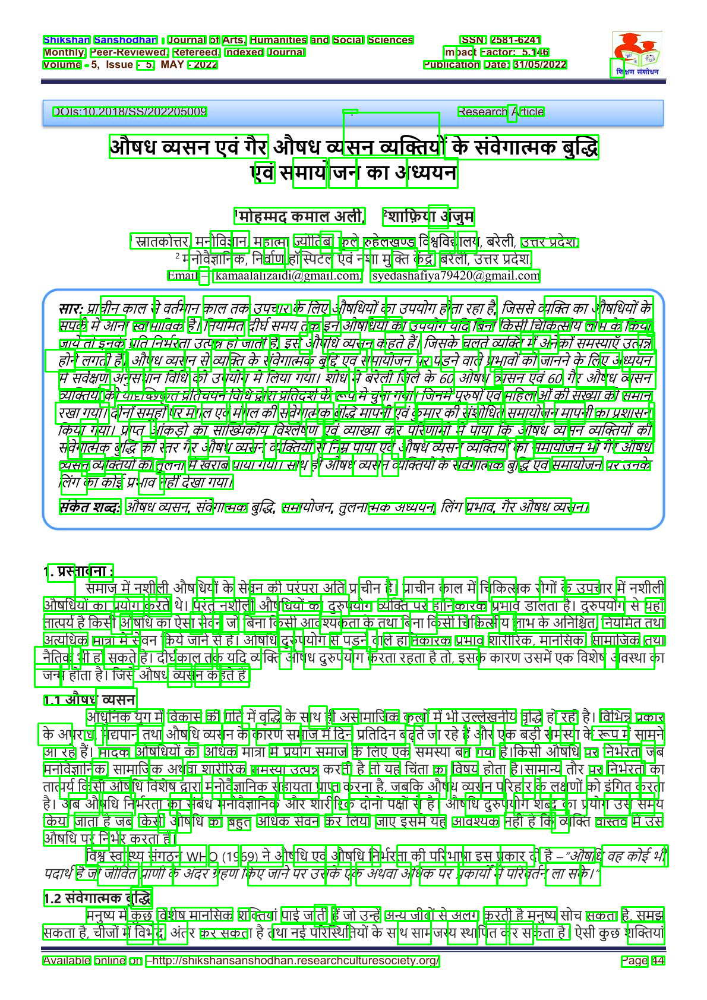

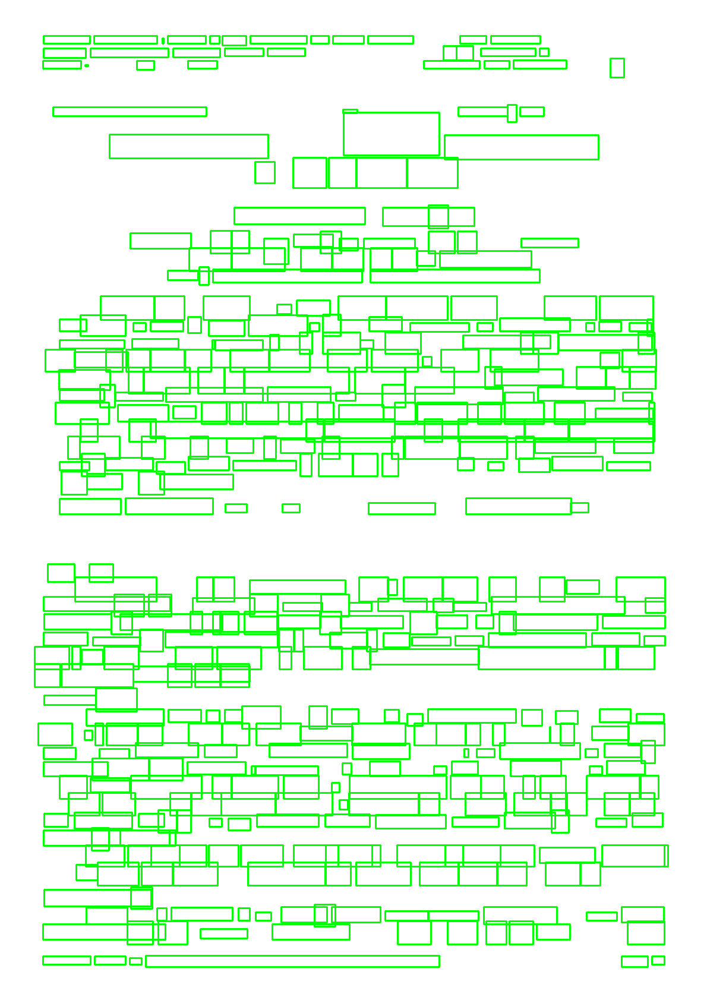

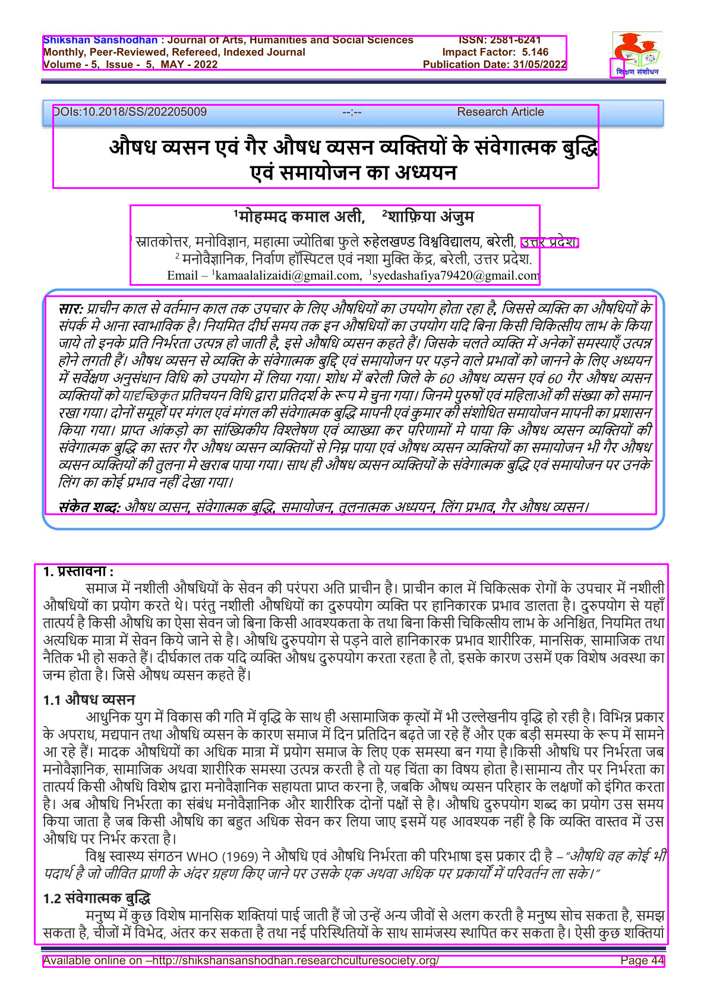

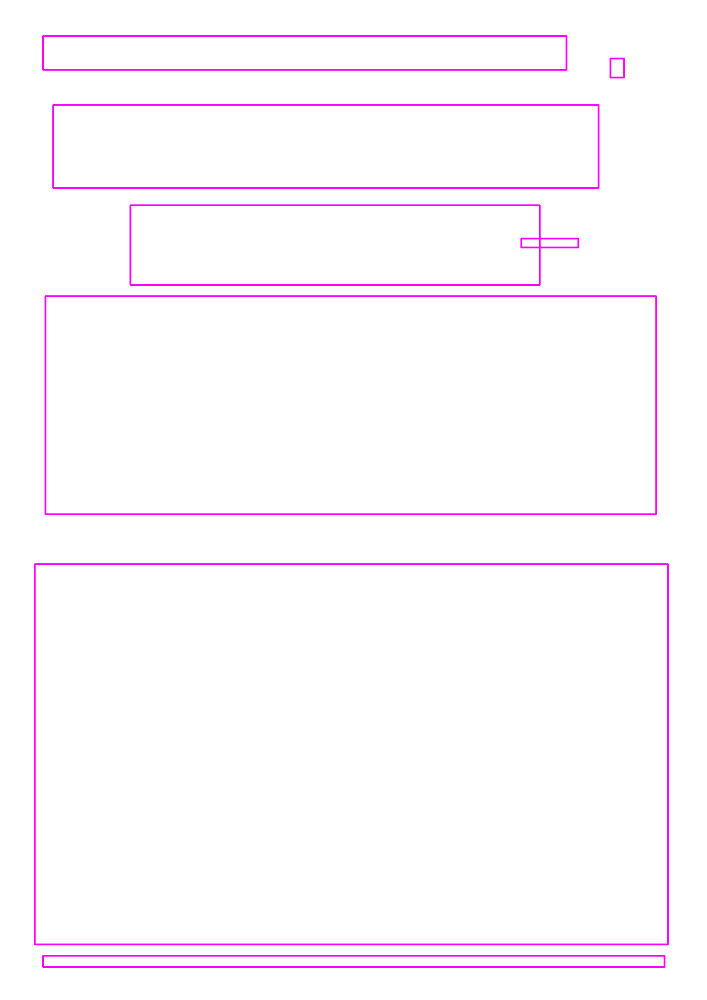

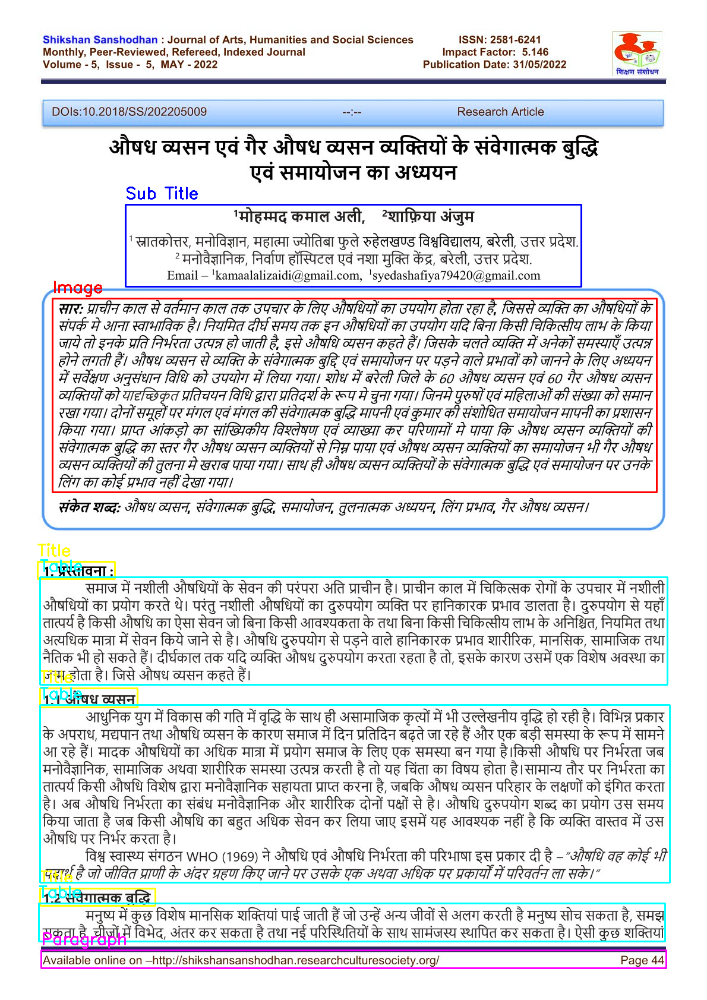

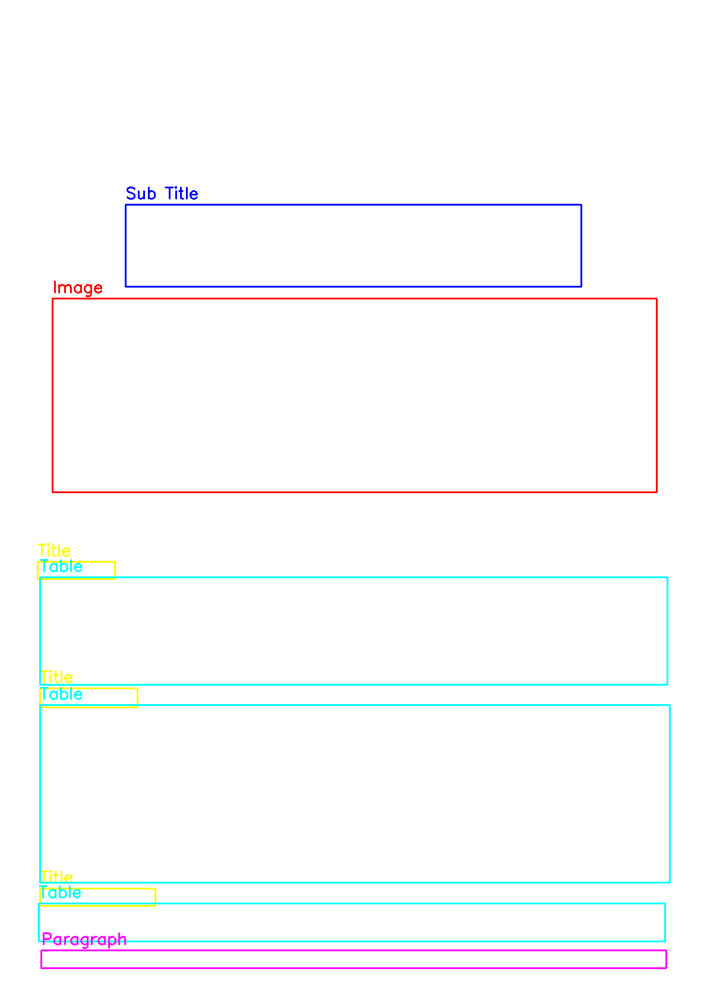

/usr/local/lib/python3.10/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


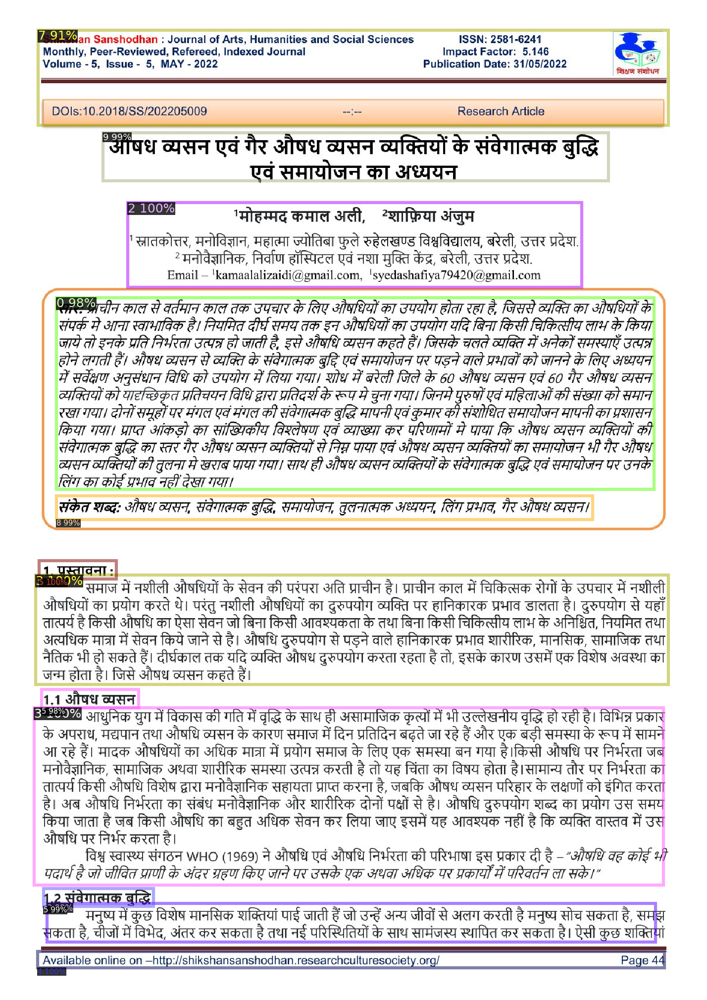

/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


True Positives: 12
False Positives: 0.0
False Negatives: 0.0
Precision: 1.0
Recall: 1.0
F1-Score: 1.0
IoU Score: 0.6060998633128613
Mean IoU: nan


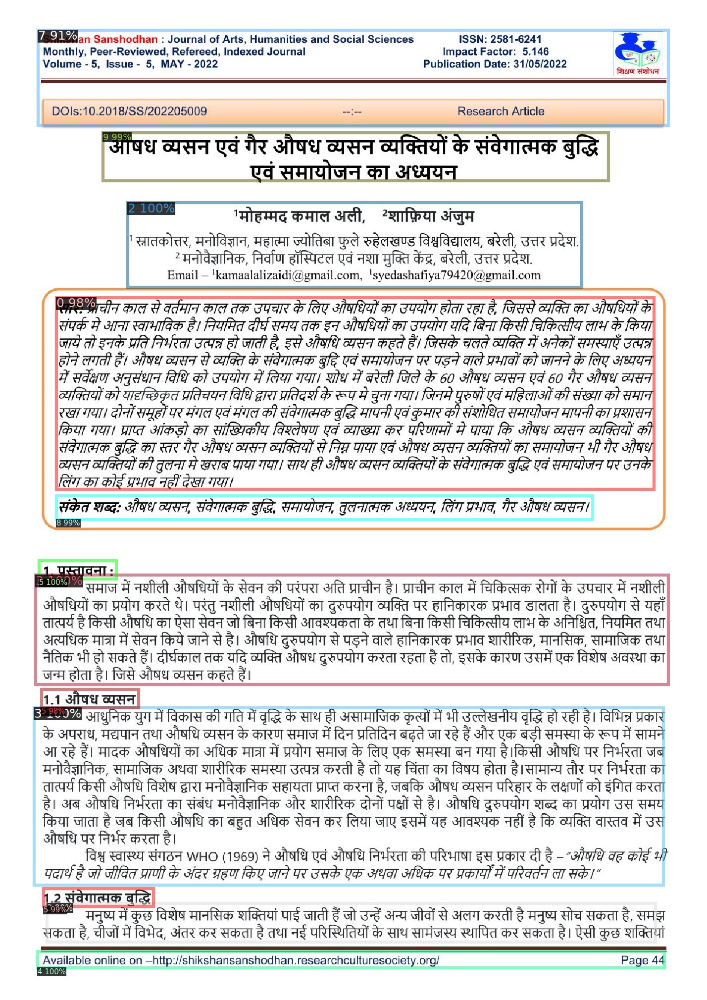

In [ ]:
import cv2
import numpy as np
import pytesseract
import os
from shapely.geometry import Polygon, box as shapely_box
from google.colab.patches import cv2_imshow
from io import BytesIO
from PIL import Image
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import ipywidgets as widgets
from IPython.display import display, clear_output

os.environ['TESSDATA_PREFIX'] = '/usr/share/tesseract-ocr/4.00/tessdata'

# Visualization functions
def visualize_word_boxes_on_image(image, word_boxes):
    image_copy = image.copy()  # Create a fresh copy of the image
    for box in word_boxes:
        cv2.rectangle(image_copy, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
    cv2_imshow(image_copy)

def visualize_word_boxes_on_white(image, word_boxes):
    height, width, _ = image.shape
    white_img = np.ones_like(image) * 255
    for box in word_boxes:
        cv2.rectangle(white_img, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
    cv2_imshow(white_img)

def visualize_paragraph_boxes_on_image(image, paragraph_boxes):
    image_copy = image.copy()  # Create a fresh copy of the image
    for box in paragraph_boxes:
        cv2.rectangle(image_copy, (box[0], box[1]), (box[2], box[3]), (255, 0, 255), 2)
    cv2_imshow(image_copy)

def visualize_paragraph_boxes_on_white(image, paragraph_boxes):
    height, width, _ = image.shape
    white_img = np.ones_like(image) * 255
    for box in paragraph_boxes:
        cv2.rectangle(white_img, (box[0], box[1]), (box[2], box[3]), (255, 0, 255), 2)
    cv2_imshow(white_img)

def visualize_yolo_annotations(image, annotation_data):
    image_copy = image.copy()  # Create a fresh copy of the image
    height, width, _ = image.shape
    label_colors = {
        "Image": (0, 0, 255),
        "Image Description": (0, 255, 0),
        "Sub Title": (255, 0, 0),
        "Table": (255, 255, 0),
        "Paragraph": (255, 0, 255),
        "Title": (0, 255, 255)
    }

    for line in annotation_data:
        data = line.strip().split()
        class_id, x_center, y_center, w, h = map(float, data)
        x_center *= width
        y_center *= height
        w *= width
        h *= height
        xmin = int(x_center - w / 2)
        ymin = int(y_center - h / 2)
        xmax = int(x_center + w / 2)
        ymax = int(y_center + h / 2)

        label_names = list(label_colors.keys())
        if 0 <= int(class_id) < len(label_names):
            label_name = label_names[int(class_id)]
            color = label_colors[label_name]
            label = f"{label_name}"
            cv2.rectangle(image_copy, (xmin, ymin), (xmax, ymax), color, 2)
            cv2.putText(image_copy, label, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

    cv2_imshow(image_copy)

def visualize_yolo_on_white(image, annotation_data):
    height, width, _ = image.shape
    white_img = np.ones_like(image) * 255
    label_colors = {
        "Image": (0, 0, 255),
        "Image Description": (0, 255, 0),
        "Sub Title": (255, 0, 0),
        "Table": (255, 255, 0),
        "Paragraph": (255, 0, 255),
        "Title": (0, 255, 255)
    }

    for line in annotation_data:
        data = line.strip().split()
        class_id, x_center, y_center, w, h = map(float, data)
        x_center *= width
        y_center *= height
        w *= width
        h *= height
        xmin = int(x_center - w / 2)
        ymin = int(y_center - h / 2)
        xmax = int(x_center + w / 2)
        ymax = int(y_center + h / 2)

        label_names = list(label_colors.keys())
        if 0 <= int(class_id) < len(label_names):
            label_name = label_names[int(class_id)]
            color = label_colors[label_name]
            label = f"{label_name}"
            cv2.rectangle(white_img, (xmin, ymin), (xmax, ymax), color, 2)
            cv2.putText(white_img, label, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

    cv2_imshow(white_img)

# Combine word boxes into paragraphs
def combine_boxes(boxes, threshold_vertical_gap=8, threshold_horizontal_gap=14):
    if not boxes:
        return []

    boxes.sort(key=lambda box: box[1])

    lines = []
    current_line = [boxes[0]]
    for box in boxes[1:]:
        prev_box = current_line[-1]
        vertical_gap = box[1] - prev_box[3]
        if vertical_gap <= max(threshold_vertical_gap, prev_box[3] - prev_box[1]):
            current_line.append(box)
        else:
            lines.append(current_line)
            current_line = [box]
    lines.append(current_line)

    paragraph_boxes = []
    for line in lines:
        line.sort(key=lambda box: box[0])
        current_paragraph = [line[0]]
        for box in line[1:]:
            prev_box = current_paragraph[-1]
            horizontal_gap = box[0] - prev_box[2]
            if horizontal_gap <= max(threshold_horizontal_gap, prev_box[2] - prev_box[0]):
                current_paragraph.append(box)
            else:
                min_x = min(b[0] for b in current_paragraph)
                min_y = min(b[1] for b in current_paragraph)
                max_x = max(b[2] for b in current_paragraph)
                max_y = max(b[3] for b in current_paragraph)
                paragraph_boxes.append((min_x, min_y, max_x, max_y))
                current_paragraph = [box]

        min_x = min(b[0] for b in current_paragraph)
        min_y = min(b[1] for b in current_paragraph)
        max_x = max(b[2] for b in current_paragraph)
        max_y = max(b[3] for b in current_paragraph)
        paragraph_boxes.append((min_x, min_y, max_x, max_y))

    return paragraph_boxes

def calculate_iou(box1, box2):
    """Calculates Intersection over Union (IoU) between two boxes."""
    poly_1 = Polygon([(box1[0], box1[1]), (box1[2], box1[1]), (box1[2], box1[3]), (box1[0], box1[3])])
    poly_2 = Polygon([(box2[0], box2[1]), (box2[2], box2[1]), (box2[2], box2[3]), (box2[0], box2[3])])
    iou = poly_1.intersection(poly_2).area / poly_1.union(poly_2).area
    return iou


def calculate_accuracies(gt_boxes, pred_boxes):
    tp = 0  # True Positives
    fp = 0  # False Positives
    fn = 0  # False Negatives
    total_gt_area = 0  # Total area of ground truth boxes
    total_pred_area = 0  # Total area of predicted boxes
    intersection_area = 0  # Total overlapping area between GT and predictions

    gt_matched = np.zeros(len(gt_boxes))  # Keep track of matched ground truth boxes
    pred_matched = np.zeros(len(pred_boxes))  # Keep track of matched predicted boxes

    for i, gt_box in enumerate(gt_boxes):
        iou_max = 0
        match_j = -1
        for j, pred_box in enumerate(pred_boxes):
            iou = calculate_iou(gt_box, pred_box)
            if iou > iou_max:
                iou_max = iou
                match_j = j
        if iou_max > 0.5:  # IoU threshold for a correct match
            tp += 1
            gt_matched[i] = 1
            pred_matched[match_j] = 1
            total_gt_area += (gt_box[2] - gt_box[0]) * (gt_box[3] - gt_box[1])
            total_pred_area += (pred_box[2] - pred_box[0]) * (pred_box[3] - pred_box[1])
            intersection_area += iou_max * (gt_box[2] - gt_box[0]) * (gt_box[3] - gt_box[1])

    fn = len(gt_boxes) - sum(gt_matched)
    fp = len(pred_boxes) - sum(pred_matched)

    # Calculate accuracy parameters
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
    iou_score = intersection_area / (total_gt_area + total_pred_area - intersection_area) if (total_gt_area + total_pred_area - intersection_area) > 0 else 0

    # Additional accuracy parameters
    mean_iou = np.mean([calculate_iou(gt_boxes[i], pred_boxes[j])
                       for i in range(len(gt_boxes)) if gt_matched[i]
                       for j in range(len(pred_boxes)) if pred_matched[j] and iou > 0.5]) if tp > 0 else 0

    return {
        "True Positives": tp,
        "False Positives": fp,
        "False Negatives": fn,
        "Precision": precision,
        "Recall": recall,
        "F1-Score": f1_score,
        "IoU Score": iou_score,
        "Mean IoU": mean_iou,
    }

# Setup predictor for multiple datasets with dynamic classes
def setup_predictor(dataset_type):
    # Define weights and class information dynamically
    model_info = {
        'novel': {
            'weights': '/content/drive/MyDrive/detectron_dataset/novel/output/model_final.pth',
            'classes': ['Image', 'Image Description', 'Sub Title', 'Table', 'Paragraph', 'Title']
        },
        'paper': {
            'weights': '/content/drive/MyDrive/detectron_dataset/paper/output/model_final.pth',
            'classes': ['Abstract Body', 'Abstract Heading', 'Author', 'Body', 'Footer Info', 'Heading', 'Journal Header', 'Journal Info', 'Keywords', 'Title']
        },
        'story': {
            'weights': '/content/drive/MyDrive/detectron_dataset/story/output/model_final.pth',
            'classes': ['Image', 'Sub Title', 'Text Block', 'Title']
        }
    }

    # Fetch the appropriate model weight path and classes based on dataset type
    model_data = model_info[dataset_type]
    model_weights = model_data['weights']
    class_names = model_data['classes']
    num_classes = len(class_names)

    # Setup the configuration
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
    cfg.MODEL.WEIGHTS = model_weights
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = num_classes
    cfg.MODEL.DEVICE = "cpu"

    return DefaultPredictor(cfg), class_names, num_classes

# Process and display results
def process_uploaded_files_with_model(image_file, annotation_file, dataset_type):
    image_data = BytesIO(image_file['content'])
    image = np.array(Image.open(image_data))
    annotation_data = annotation_file['content'].decode('utf-8').strip().split("\n")

    # Extracting word-level bounding boxes using pytesseract
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    _, binary_image = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY_INV)
    data = pytesseract.image_to_data(binary_image, output_type=pytesseract.Output.DICT)
    word_boxes = []
    for i, word in enumerate(data['text']):
        if word.strip():
            (x, y, w, h) = (data['left'][i], data['top'][i], data['width'][i], data['height'][i])
            word_boxes.append((x, y, x + w, y + h))

    # Combine word boxes into paragraph boxes
    paragraph_boxes = combine_boxes(word_boxes)

    # Get the predictor, class names, and class count dynamically based on the selected model
    predictor, class_names, num_classes = setup_predictor(dataset_type)

    # Visualize the bounding boxes
    visualize_word_boxes_on_image(image, word_boxes)
    visualize_word_boxes_on_white(image, word_boxes)
    visualize_paragraph_boxes_on_image(image, paragraph_boxes)
    visualize_paragraph_boxes_on_white(image, paragraph_boxes)
    visualize_yolo_annotations(image, annotation_data)
    visualize_yolo_on_white(image, annotation_data)

    # Extract ground truth boxes from annotation data
    height, width, _ = image.shape
    gt_boxes = []
    for line in annotation_data:
        data = line.strip().split()
        class_id, x_center, y_center, w, h = map(float, data)
        x_center *= width
        y_center *= height
        w *= width
        h *= height
        xmin = int(x_center - w / 2)
        ymin = int(y_center - h / 2)
        xmax = int(x_center + w / 2)
        ymax = int(y_center + h / 2)
        gt_boxes.append((xmin, ymin, xmax, ymax))

    # Predict and get predicted boxes
    outputs = predictor(np.array(Image.open(BytesIO(image_file['content']))))
    pred_boxes = outputs["instances"].pred_boxes.tensor.cpu().numpy()
    pred_boxes = [[int(coord) for coord in box] for box in pred_boxes]

    # Visualize and predict using the updated predictor
    outputs = predictor(np.array(Image.open(BytesIO(image_file['content']))))
    visualizer = Visualizer(np.array(Image.open(BytesIO(image_file['content']))), MetadataCatalog.get(dataset_type), scale=1.2)
    result_image = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(result_image.get_image()[:, :, ::-1])

    # Calculate and display accuracies (This is now after Detectron2 output)
    accuracies = calculate_accuracies(gt_boxes, pred_boxes)
    for key, value in accuracies.items():
        print(f"{key}: {value}")

# Dropdown for selecting dataset
dataset_type_dropdown = widgets.Dropdown(
    options=['novel', 'paper', 'story'],
    value='novel',
    description='Dataset Type:',
)

# File upload widgets
upload_image_widget = widgets.FileUpload(accept='image/*', multiple=False)
upload_annotation_widget = widgets.FileUpload(accept='.txt', multiple=False)

display(dataset_type_dropdown, upload_image_widget, upload_annotation_widget)

def on_upload_and_selection_change(change):
    if upload_image_widget.value and upload_annotation_widget.value and dataset_type_dropdown.value:
        image_file = next(iter(upload_image_widget.value.values()))
        annotation_file = next(iter(upload_annotation_widget.value.values()))
        dataset_type = dataset_type_dropdown.value

        # Get the predictor, class names, and class count dynamically based on the selected model
        predictor, class_names, num_classes = setup_predictor(dataset_type)

        # Process the image with the updated model setup
        process_uploaded_files_with_model(image_file, annotation_file, dataset_type)

        # Visualize and predict using the updated predictor
        outputs = predictor(np.array(Image.open(BytesIO(image_file['content']))))
        visualizer = Visualizer(np.array(Image.open(BytesIO(image_file['content']))), MetadataCatalog.get(dataset_type), scale=1.2)
        result_image = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
        cv2_imshow(result_image.get_image()[:, :, ::-1])

# Observers
upload_image_widget.observe(on_upload_and_selection_change, names='value')
upload_annotation_widget.observe(on_upload_and_selection_change, names='value')
dataset_type_dropdown.observe(on_upload_and_selection_change, names='value')

Dropdown(description='Dataset Type:', options=('novel', 'paper', 'story'), value='novel')

FileUpload(value={'2b6bfef1-675.jpg': {'metadata': {'name': '2b6bfef1-675.jpg', 'type': 'image/jpeg', 'size': …


Processing image with novel model...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

Original Image:


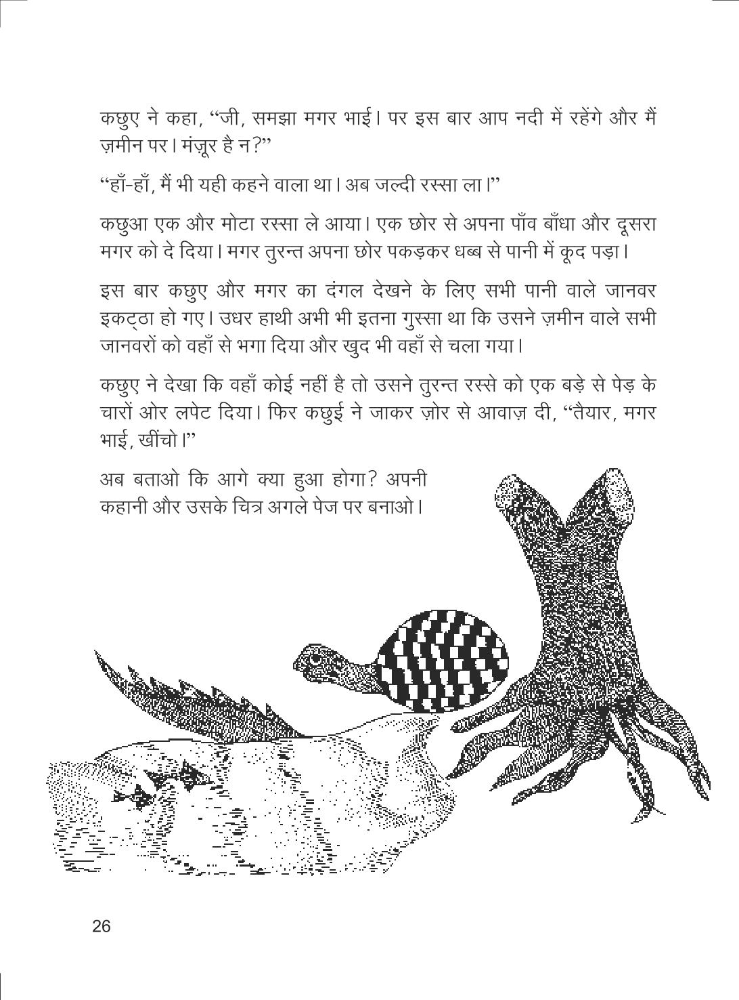


Detectron2 Predictions:


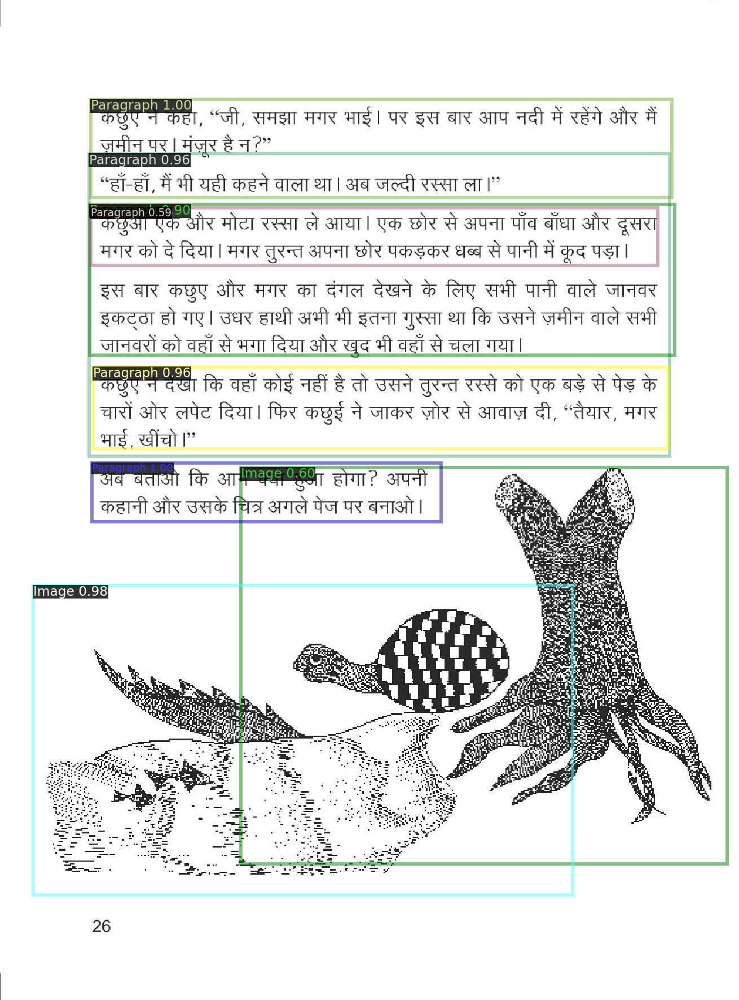


Accuracy Metrics (comparing with OCR baseline):
True Positives: 1
False Positives: 7.000
False Negatives: 114.000
Precision: 0.125
Recall: 0.009
F1-Score: 0.016
IoU Score: 0.654
Mean IoU: 0.670

Detailed Detection Results:
Detection 1:
  Class: Paragraph
  Confidence: 0.997
  Bounding Box: (x1=133, y1=147, x2=992, y2=292)

Detection 2:
  Class: Paragraph
  Confidence: 0.996
  Bounding Box: (x1=136, y1=683, x2=651, y2=770)

Detection 3:
  Class: Image
  Confidence: 0.980
  Bounding Box: (x1=49, y1=863, x2=845, y2=1321)

Detection 4:
  Class: Paragraph
  Confidence: 0.959
  Bounding Box: (x1=131, y1=227, x2=988, y2=673)

Detection 5:
  Class: Paragraph
  Confidence: 0.955
  Bounding Box: (x1=137, y1=541, x2=986, y2=662)

Detection 6:
  Class: Paragraph
  Confidence: 0.897
  Bounding Box: (x1=132, y1=301, x2=996, y2=524)

Detection 7:
  Class: Image
  Confidence: 0.596
  Bounding Box: (x1=355, y1=689, x2=1073, y2=1275)

Detection 8:
  Class: Paragraph
  Confidence: 0.588
  Bounding Box: 

In [ ]:
import cv2
import numpy as np
import pytesseract
from PIL import Image
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
import ipywidgets as widgets
from IPython.display import display, clear_output
from io import BytesIO
from google.colab.patches import cv2_imshow
from shapely.geometry import Polygon

def calculate_iou(box1, box2):
    """Calculates Intersection over Union (IoU) between two boxes."""
    poly_1 = Polygon([(box1[0], box1[1]), (box1[2], box1[1]), (box1[2], box1[3]), (box1[0], box1[3])])
    poly_2 = Polygon([(box2[0], box2[1]), (box2[2], box2[1]), (box2[2], box2[3]), (box2[0], box2[3])])
    try:
        iou = poly_1.intersection(poly_2).area / poly_1.union(poly_2).area
        return iou
    except:
        return 0

def calculate_accuracies(baseline_boxes, pred_boxes):
    tp = 0  # True Positives
    fp = 0  # False Positives
    fn = 0  # False Negatives
    total_baseline_area = 0
    total_pred_area = 0
    intersection_area = 0

    baseline_matched = np.zeros(len(baseline_boxes))
    pred_matched = np.zeros(len(pred_boxes))

    for i, baseline_box in enumerate(baseline_boxes):
        iou_max = 0
        match_j = -1
        for j, pred_box in enumerate(pred_boxes):
            iou = calculate_iou(baseline_box, pred_box)
            if iou > iou_max:
                iou_max = iou
                match_j = j

        if iou_max > 0.5:
            tp += 1
            baseline_matched[i] = 1
            pred_matched[match_j] = 1
            total_baseline_area += (baseline_box[2] - baseline_box[0]) * (baseline_box[3] - baseline_box[1])
            pred_box = pred_boxes[match_j]
            total_pred_area += (pred_box[2] - pred_box[0]) * (pred_box[3] - pred_box[1])
            intersection_area += iou_max * (baseline_box[2] - baseline_box[0]) * (baseline_box[3] - baseline_box[1])

    fn = len(baseline_boxes) - sum(baseline_matched)
    fp = len(pred_boxes) - sum(pred_matched)

    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
    iou_score = intersection_area / (total_baseline_area + total_pred_area - intersection_area) if (total_baseline_area + total_pred_area - intersection_area) > 0 else 0

    mean_iou = np.mean([calculate_iou(baseline_boxes[i], pred_boxes[j])
                       for i in range(len(baseline_boxes)) if baseline_matched[i]
                       for j in range(len(pred_boxes)) if pred_matched[j] and calculate_iou(baseline_boxes[i], pred_boxes[j]) > 0.5]) if tp > 0 else 0

    return {
        "True Positives": tp,
        "False Positives": fp,
        "False Negatives": fn,
        "Precision": precision,
        "Recall": recall,
        "F1-Score": f1_score,
        "IoU Score": iou_score,
        "Mean IoU": mean_iou,
    }

def get_tesseract_boxes(image):
    """Extract text blocks using Tesseract OCR"""
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    _, binary_image = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY_INV)
    data = pytesseract.image_to_data(binary_image, output_type=pytesseract.Output.DICT)

    boxes = []
    for i, conf in enumerate(data['conf']):
        if conf > 0:
            (x, y, w, h) = (data['left'][i], data['top'][i], data['width'][i], data['height'][i])
            boxes.append((x, y, x + w, y + h))

    return boxes

def setup_predictor(dataset_type):
    model_info = {
        'novel': {
            'weights': '/content/drive/MyDrive/detectron_dataset/novel/output/model_final.pth',
            'classes': ['Image', 'Image Description', 'Sub Title', 'Table', 'Paragraph', 'Title']
        },
        'paper': {
            'weights': '/content/drive/MyDrive/detectron_dataset/paper/output/model_final.pth',
            'classes': ['Abstract Body', 'Abstract Heading', 'Author', 'Body', 'Footer Info', 'Heading', 'Journal Header', 'Journal Info', 'Keywords', 'Title']
        },
        'story': {
            'weights': '/content/drive/MyDrive/detectron_dataset/story/output/model_final.pth',
            'classes': ['Image', 'Sub Title', 'Text Block', 'Title']
        }
    }

    model_data = model_info[dataset_type]
    model_weights = model_data['weights']
    class_names = model_data['classes']
    num_classes = len(class_names)

    # Register the dataset and metadata
    if dataset_type not in DatasetCatalog.list():
        DatasetCatalog.register(dataset_type, lambda: [])
    MetadataCatalog.get(dataset_type).set(thing_classes=class_names)

    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
    cfg.MODEL.WEIGHTS = model_weights
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = num_classes
    cfg.MODEL.DEVICE = "cpu"

    return DefaultPredictor(cfg), class_names, num_classes

def visualize_predictions(image, outputs, metadata):
    """Custom visualization function to show labels with boxes"""
    v = Visualizer(image, metadata, scale=1.2)
    instances = outputs["instances"].to("cpu")

    # Draw the bounding boxes and labels
    boxes = instances.pred_boxes.tensor.numpy()
    classes = instances.pred_classes.numpy()
    scores = instances.scores.numpy()

    v = v.overlay_instances(
        boxes=boxes,
        labels=[f"{metadata.thing_classes[c]} {s:.2f}" for c, s in zip(classes, scores)]
    )

    return v.get_image()[:, :, ::-1]

def process_image_with_model(image_file, dataset_type):
    predictor, class_names, num_classes = setup_predictor(dataset_type)

    # Read and process the image
    image = np.array(Image.open(BytesIO(image_file['content'])))

    # Show original image
    print("Original Image:")
    cv2_imshow(image)

    # Get Detectron2 predictions
    outputs = predictor(image)

    # Visualize predictions with custom visualization
    print("\nDetectron2 Predictions:")
    metadata = MetadataCatalog.get(dataset_type)
    result_image = visualize_predictions(image, outputs, metadata)
    cv2_imshow(result_image)

    # Get predicted boxes from Detectron2
    pred_boxes = outputs["instances"].pred_boxes.tensor.cpu().numpy()
    pred_boxes = [[int(coord) for coord in box] for box in pred_boxes]

    # Get baseline boxes using Tesseract
    baseline_boxes = get_tesseract_boxes(image)

    # Calculate accuracies
    print("\nAccuracy Metrics (comparing with OCR baseline):")
    accuracies = calculate_accuracies(baseline_boxes, pred_boxes)
    for key, value in accuracies.items():
        if isinstance(value, float):
            print(f"{key}: {value:.3f}")
        else:
            print(f"{key}: {value}")

    # Print detailed detection results
    print("\nDetailed Detection Results:")
    pred_classes = outputs["instances"].pred_classes.cpu().numpy()
    pred_scores = outputs["instances"].scores.cpu().numpy()
    for i, (cls, score, box) in enumerate(zip(pred_classes, pred_scores, pred_boxes)):
        class_name = class_names[cls]
        print(f"Detection {i+1}:")
        print(f"  Class: {class_name}")
        print(f"  Confidence: {score:.3f}")
        print(f"  Bounding Box: (x1={box[0]}, y1={box[1]}, x2={box[2]}, y2={box[3]})")
        print()

# Create widgets
dataset_type_dropdown = widgets.Dropdown(
    options=['novel', 'paper', 'story'],
    value='novel',
    description='Dataset Type:',
)

upload_image_widget = widgets.FileUpload(
    accept='image/*',
    multiple=False,
    description='Upload Image'
)

display(dataset_type_dropdown, upload_image_widget)

def on_upload_and_selection_change(change):
    if upload_image_widget.value and dataset_type_dropdown.value:
        clear_output(wait=True)
        display(dataset_type_dropdown, upload_image_widget)

        image_file = next(iter(upload_image_widget.value.values()))
        dataset_type = dataset_type_dropdown.value

        print(f"\nProcessing image with {dataset_type} model...")
        process_image_with_model(image_file, dataset_type)

# Observers
upload_image_widget.observe(on_upload_and_selection_change, names='value')
dataset_type_dropdown.observe(on_upload_and_selection_change, names='value')